In [65]:
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import netCDF4 as nc|
import numpy as np
import re
import datetime
from matplotlib.ticker import FixedLocator
from matplotlib.backends.backend_pdf import PdfPages
import mpld3
mpld3.enable_notebook()
import site
import importlib
import plot_settings
import os
#from lib.plot       import mc_set_outtype, mc_set_matplotlib, mc_plot_begin, mc_plot_save, mc_plot_end

In [74]:
importlib.reload(site)
site.esat(25)*.1

3.1667404621965964

,SWdown,Tair,Rainf,Qair,Wind,PSurf,LWdown,SWdown_qc,Tair_qc,Rainf_qc,Qair_qc,Wind_qc,PSurf_qc,LWdown_qc,LAI
time,,,,,,,,,,,,,,,
2001-01-01 00:00:00.000000,0.0,15.929993,0.0,0.009092,0.577427,100920.0,323.855072,1,1,1,1,1,1,1,1.5
2001-01-01 01:00:00.000000,0.0,15.446930,0.0,0.009124,0.577427,100920.0,321.695801,1,1,1,1,1,1,1,1.5
2001-01-01 02:00:00.000006,0.0,15.003265,0.0,0.009156,0.577427,100920.0,319.722260,1,1,1,1,1,1,1,1.5
2001-01-01 03:00:00.000000,0.0,14.590729,0.0,0.009187,0.577427,100920.0,317.895264,1,1,1,1,1,1,1,1.5
2001-01-01 04:00:00.000000,0.0,14.203522,0.0,0.009219,0.577427,100920.0,316.187653,1,1,1,1,1,1,1,1.5


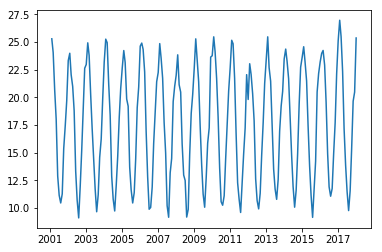

In [81]:
met_filename1 = '/Users/hav014/Data/BIOS3/site_met/Cump_met_2001_2017_LAIc_15.nc'
dfmet1=site.read_cable_input(met_filename1)
dfmet1_M=dfmet1.resample('M').mean()
plt.plot(dfmet1_M['Tair'])
dfmet1[:5]

In [90]:
CABLE_SITE_fname1 = '/Users/hav014/Data/BIOS3/190207/Cumberland_POP_CNP_out_casa_opt_LAIv_AWAP_forcing.nc'
importlib.reload(site)
df1=site.read_cable_single_site(CABLE_SITE_fname1)
df1_M=df1.resample('M').mean()

AttributeError: NetCDF: Attribute not found

,SWdown,LWdown,Tair,Rainf,Snowf,Qair,Wind,PSurf,CO2air,Qle,...,SoilMoist5,SoilTemp6,SoilMoist6,SoilTempWeighted,SoilMoistWeighted,season,day,TairDailyMean,SoilTempWeightedDailyMean,SoilTemp1DailyMean
dates,,,,,,,,,,,,,,,,,,,,,
2001-01-01 01:00:00,0.0,323.855072,15.929993,0.0,0.0,0.009092,0.577427,1009.199951,370.5,5.145106,...,-272.93869,19.647491,-272.996918,25.128540,0.187482,1,2451910.0,21.453428,25.799772,27.552282
2001-01-01 02:00:00,0.0,321.695801,15.446930,0.0,0.0,0.009124,0.577427,1009.199951,370.5,4.379318,...,-272.93869,19.648102,-272.996918,24.812103,0.187480,1,2451910.0,21.453428,25.799772,27.552282
2001-01-01 03:00:00,0.0,319.722260,15.003265,0.0,0.0,0.009156,0.577427,1009.199951,370.5,3.711579,...,-272.93869,19.648682,-272.996918,24.515167,0.187482,1,2451910.0,21.453428,25.799772,27.552282
2001-01-01 04:00:00,0.0,317.895264,14.590729,0.0,0.0,0.009187,0.577427,1009.199951,370.5,3.134371,...,-272.93869,19.649292,-272.996918,24.234375,0.187486,1,2451910.0,21.453428,25.799772,27.552282
2001-01-01 05:00:00,0.0,316.187653,14.203522,0.0,0.0,0.009219,0.577427,1009.199951,370.5,2.634107,...,-272.93869,19.649902,-272.996918,23.967438,0.187494,1,2451910.0,21.453428,25.799772,27.552282


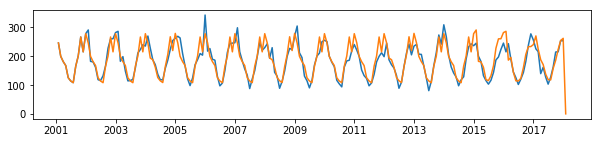

In [89]:
fig=plt.figure(figsize=(10, 2))

plt.plot(dfmet1_M['SWdown'])
plt.plot(df1_M['SWdown'])
df1[:5]

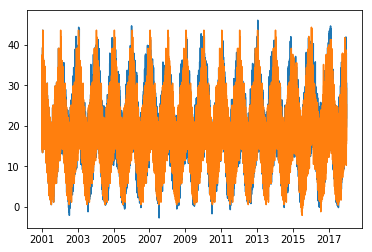

In [78]:
plt.plot(dfmet1['Tair'])
plt.plot(df1['Tair'])

In [3]:
#tstep = 3600 # site data time step
#sitename='Tumbarumba'
#CABLE_SITE_fname1 = '/Users/hav014/Data/BIOS3/190124/Tumba_POP_CNP_out_cable.nc'
#CABLE_SITE_fname2 = '/Users/hav014/Data/BIOS3/190124/bios_out_cable_Tumb.nc'



tstep = 1800 # site data time step
sitename='CumberlandPlain'
#CABLE_SITE_fname1 = '/Users/hav014/Data/BIOS3/CumbPlains/Cumberland_POP_CNP_out_cable_coord_vLAI.nc' # site
#CABLE_SITE_fname2 = '/Users/hav014/Data/BIOS3/190124/bios_out_cable_2014_2017_Cumb.nc' #BIOS
#CABLE_SITE_fname1 = '/Users/hav014/Data/BIOS3/190124/Cumberland_POP_CNP_out_cable_optimised.nc'
#CABLE_SITE_fname2 = '/Users/hav014/Data/BIOS3/190124/Cumberland_POP_CNP_out_cable_AWAP_forcing.nc' #BIOS

CABLE_SITE_fname1 = '/Users/hav014/Data/BIOS3/190207/Cumberland_POP_CNP_out_cable.nc'
CABLE_SITE_fname2 = '/Users/hav014/Data/BIOS3/190131/Cumberland_POP_CNP_out_cable_opt_LAIv_AWAP_forcing_2014_2017.nc' # AWAP forcing
#CABLE_SITE_fname2 = '/Users/hav014/Data/BIOS3/190125/Cumberland_POP_CNP_2014_2017_out_cable_AWAP_forcing_1.nc'
#CABLE_SITE_fname3 = '/Users/hav014/Data/BIOS3/190124/Tumba_POP_CNP_out_cable.nc'
#CABLE_SITE_fname2 = '/Users/hav014/Data/BIOS3/190124/bios_out_cable.nc'

plot_dir = '/Users/hav014/Data/BIOS3/190207/'
plot_fname = 'Cumb_LAIv_vs_LAIv_AWAP_Forcing_190207.pdf'
plot_fname1 = 'Cumb_NEP_site_met_190207.pdf'
plot_fname_Evap = 'Cumb_Evap_site_met_190207.pdf'
plot_fname_GPP = 'Cumb_GPP_site_met_190207.pdf'

In [4]:
importlib.reload(site)
df1=site.read_cable_single_site(CABLE_SITE_fname1)
df2=site.read_cable_single_site(CABLE_SITE_fname2)

SWdown
LWdown
Tair
Rainf
Snowf
Qair
Wind
PSurf
CO2air
Qle
Qh
Qg
Qs
Qsb
Evap
ECanop
TVeg
ESoil
HVeg
HSoil
RnetSoil
NEE
SoilMoist
SoilMoistIce
SoilTemp
BaresoilT
SWE
SnowMelt
SnowT
SnowDepth
SWnet
LWnet
Rnet
Albedo
visAlbedo
nirAlbedo
RadT
VegT
CanT
Fwsoil
CanopInt
LAI
vcmax
jmax
Ebal
Wbal
AutoResp
RootResp
StemResp
LeafResp
HeteroResp
GPP
GPP_shaded
GPP_sunlit
GPP_shaded_C
GPP_sunlit_C
GPP_shaded_J
GPP_sunlit_J
eta_GPP_cs
dGPPdcs
CO2s
NPP
NBP
dCdt
TotSoilCarb
TotLittCarb
SoilCarbFast
SoilCarbSlow
SoilCarbPassive
LittCarbMetabolic
LittCarbStructural
LittCarbCWD
PlantCarbLeaf
PlantCarbFineRoot
PlantCarbWood
TotLivBiomass
PlantTurnover
PlantTurnoverLeaf
PlantTurnoverFineRoot
PlantTurnoverWood
PlantTurnoverWoodDist
PlantTurnoverWoodCrowding
PlantTurnoverWoodResourceLim
Area
hc
SWdown
LWdown
Tair
Rainf
Snowf
Qair
Wind
PSurf
CO2air
Qle
Qh
Qg
Qs
Qsb
Evap
ECanop
TVeg
ESoil
HVeg
HSoil
RnetSoil
NEE
SoilMoist
SoilMoistIce
SoilTemp
BaresoilT
SWE
SnowMelt
SnowT
SnowDepth
SWnet
LWnet
Rnet
Albedo
visA

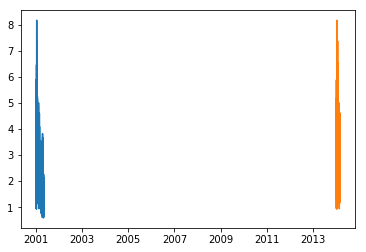

In [5]:
# plot first four days
vars = ['LWdown','SWdown','Tair','Qair','Wind','ESoil','TVeg','LAI','GPP','VegT','Fwsoil']
plt.plot(df1['vpd'][:200*15])
plt.plot(df2['vpd'][:100*15])

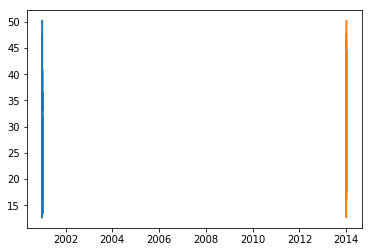

In [6]:
vars = ['LWdown','SWdown','Tair','Qair','Wind','ESoil','TVeg','LAI','GPP','VegT','Fwsoil']
plt.plot(df1['VegT'][:200])
plt.plot(df2['VegT'][:100])

In [7]:
#importlib.reload(site)
df_obs=site.read_ozflux(sitename,tstep)

In [8]:
# get Trfs
Tref = df1['Tair'].mean()
q10 = 2
df1['Trf_Ta_h'] = site.Q10(df1['Tair'],Tref,q10)
df1['Trf_Ta_d'] = site.Q10(df1['TairDailyMean'],Tref,q10)

df1['Trf_Tsoil_h']= site.Q10(df1['SoilTemp1'],Tref,q10)
df1['Trf_Tsoil_d']=site.Q10(df1['SoilTemp1DailyMean'],Tref,q10)

grouped = df1.groupby('day')
df1 = grouped.apply(site.compute_mean_Trf) # gives us df['Daily_Mean_Trf; Daily_Mean_Trf_Tsoil'] 

df1['Ta_bar'] = 10 * np.log(df1['Daily_Mean_Trf_Ta'].values)/np.log(q10) + Tref
df1['Trf_Ta_bar'] = site.Q10(df1['Ta_bar'],Tref,q10)

df1['Tsoil_bar'] = 10 * np.log(df1['Daily_Mean_Trf_Tsoil'].values)/np.log(q10) + Tref
df1['Trf_Tsoil_bar']=site.Q10(df1['Tsoil_bar'],Tref,q10)


In [9]:
# create diurnal T response function by which to correct ecosystem respiration
df1['Trf_Ta_norm'] = df1['Trf_Ta_h'][:] / df1['Trf_Ta_bar'][:]
df1['Trf_Tsoil_norm'] = df1['Trf_Tsoil_h'][:] / df1['Trf_Tsoil_bar'][:]
x = df1.index
#plt.plot(x,df['Trf_Tsoil_norm'])
#plt.plot(x,df['Trf_Ta_norm'])

In [10]:
# construct diurnal cycle by season
dfs1=[]
dfs2=[]
for i in range(4):
    dfs1.append(df1[df1['season']==i+1].groupby(lambda x: x.hour).mean())
    dfs2.append(df2[df2['season']==i+1].groupby(lambda x: x.hour).mean())

18

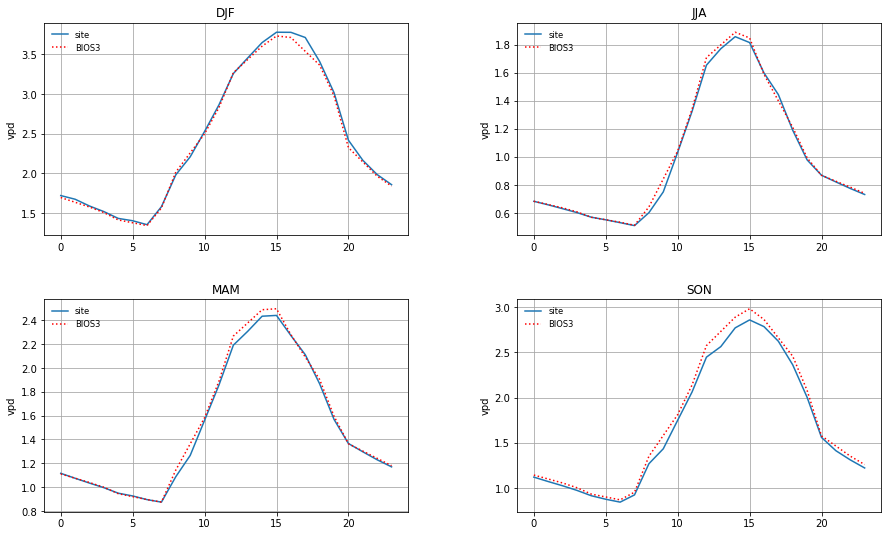

In [11]:
# compare diurnal cycle of given variable
var = 'vpd'
fig=plt.figure(figsize=(15, 9))
fig.subplots_adjust(hspace=0.3, wspace = 0.3)
x1 = dfs1[1].index
x2 = dfs2[1].index
sindex=[(0,0),(1,0),(0,1),(1,1)]
slabel = ['DJF', 'MAM', 'JJA', 'SON']
for i in range(4):
    ax = plt.subplot2grid((2,2),sindex[i])
    y1 = dfs1[i][var] 
    y2 = dfs2[i][var]
    plt.plot(x1,y1,label="site")
    plt.plot(x2,y2,label="BIOS3", linestyle=':',color = 'red')
    plt.grid(b=True, which='both', color='0.65', linestyle='-')
    plt.legend(fontsize='small',frameon=False,loc=2)
    ax.set_ylabel(var)
    ax.set_title(slabel[i])
    
fig.subplots_adjust(hspace=0.3, wspace = 0.3)
y2.size

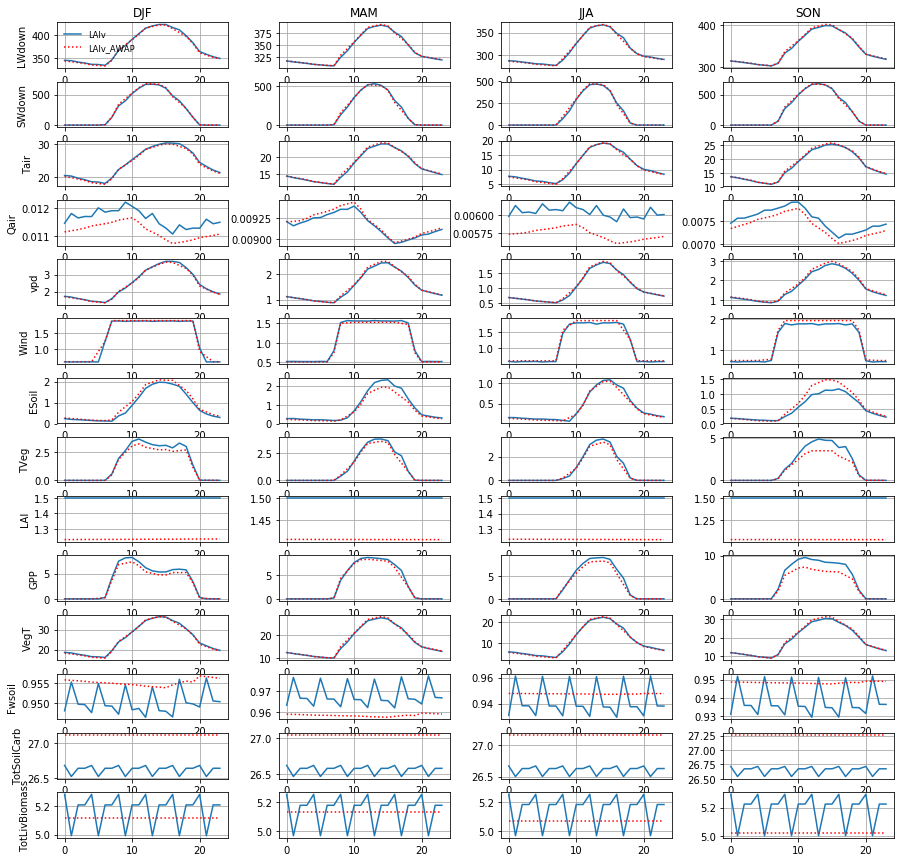

In [12]:
vars = ['LWdown','SWdown','Tair','Qair','vpd','Wind','ESoil','TVeg','LAI','GPP','VegT','Fwsoil','TotSoilCarb','TotLivBiomass']
fig=plt.figure(figsize=(15, 15))
fig.subplots_adjust(hspace=0.3, wspace = 0.3)
slabel = ['DJF', 'MAM', 'JJA', 'SON']
x1 = dfs1[1].index
x2 = dfs2[1].index
nv = len(vars)
for index, v in enumerate(vars):
    sindex = [(index,0),(index,1),(index,2),(index,3)]
    for i in range(4):
        ax = plt.subplot2grid((nv,4),sindex[i])
        y1 = dfs1[i][vars[index]]
        y2 = dfs2[i][vars[index]]
        plt.plot(x1,y1,label="LAIv")
        plt.plot(x2,y2,label="LAIv_AWAP", linestyle=':',color = 'red')
        plt.grid(b=True, which='both', color='0.65', linestyle='-')      
        if i==0:
            ax.set_ylabel(vars[index])
        if index==0:
            ax.set_title(slabel[i])
        if index==0 and i==0:
            plt.legend(fontsize='small',frameon=False,loc=2)
fig.subplots_adjust(hspace=0.3, wspace = 0.3)

In [13]:


fig.savefig(os.path.join(plot_dir, plot_fname), bbox_inches='tight',
                    pad_inches=0.1)

18

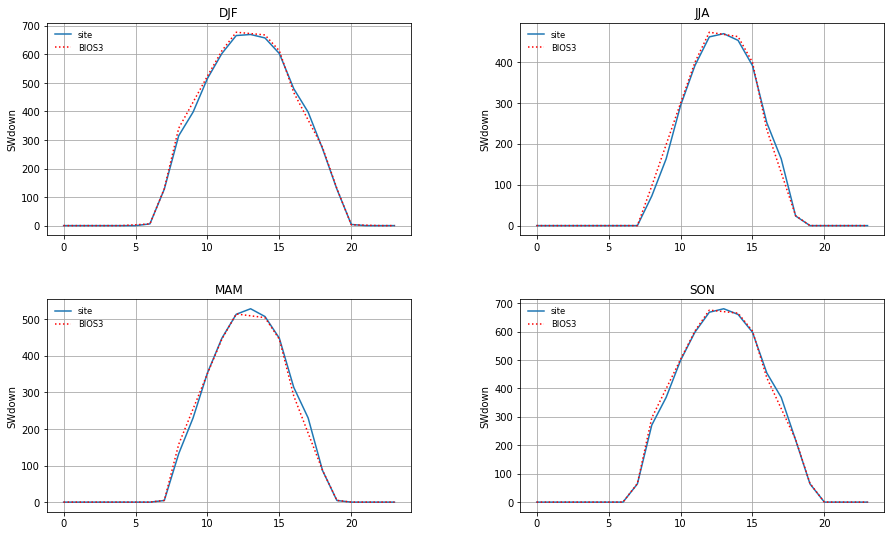

In [14]:
# compare diurnal cycle of given variable
var = 'SWdown'
fig=plt.figure(figsize=(15, 9))
fig.subplots_adjust(hspace=0.3, wspace = 0.3)
x1 = dfs1[1].index
x2 = dfs2[1].index
sindex=[(0,0),(1,0),(0,1),(1,1)]
slabel = ['DJF', 'MAM', 'JJA', 'SON']
for i in range(4):
    ax = plt.subplot2grid((2,2),sindex[i])
    y1 = dfs1[i][var] 
    y2 = dfs2[i][var]
    plt.plot(x1,y1,label="site")
    plt.plot(x2,y2,label="BIOS3", linestyle=':',color = 'red')
    plt.grid(b=True, which='both', color='0.65', linestyle='-')
    plt.legend(fontsize='small',frameon=False,loc=2)
    ax.set_ylabel(var)
    ax.set_title(slabel[i])
    
fig.subplots_adjust(hspace=0.3, wspace = 0.3)
y2.size

In [15]:
dfobs=[]
for i in range(4):
    dfobs.append(df_obs[df_obs['season']==i+1].groupby(lambda x: x.hour).mean())

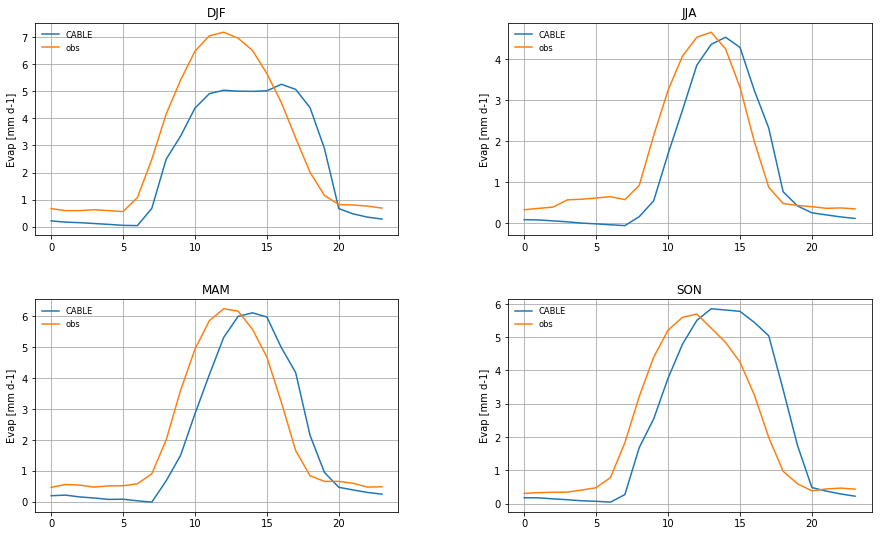

In [16]:
fig=plt.figure(figsize=(15, 9))
fig.subplots_adjust(hspace=0.3, wspace = 0.3)
x = dfs1[1].index
x1 = dfobs[1].index
sindex=[(0,0),(1,0),(0,1),(1,1)]
slabel = ['DJF', 'MAM', 'JJA', 'SON']
for i in range(4):
    ax = plt.subplot2grid((2,2),sindex[i])
    y1 = dfs1[i]['Evap']
    y3 = dfobs[i]['Evap']
    #y3 =  dfobs[i]['GPP']-dfobs[i]['NEP'] 
    y3 = y3
    plt.plot(x,y1,label="CABLE")
    plt.plot(x1,y3,label="obs")
    plt.grid(b=True, which='both', color='0.65', linestyle='-')
    plt.legend(fontsize='small',frameon=False,loc=2)
    ax.set_ylabel('Evap [mm d-1]')
    ax.set_title(slabel[i])
    
fig.subplots_adjust(hspace=0.3, wspace = 0.3)

In [17]:
fig.savefig(os.path.join(plot_dir, plot_fname_Evap), bbox_inches='tight',
                    pad_inches=0.1)

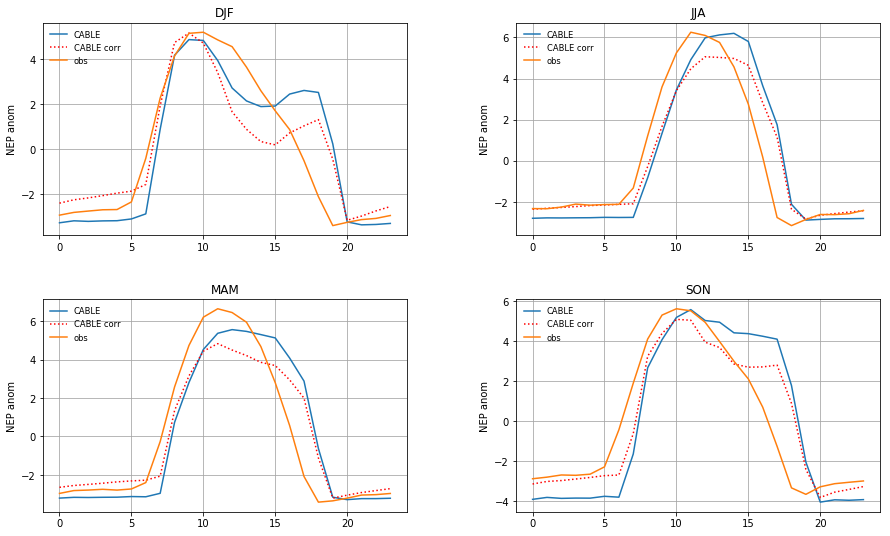

In [18]:
fig=plt.figure(figsize=(15, 9))
fig.subplots_adjust(hspace=0.3, wspace = 0.3)
x = dfs1[1].index
x1 = dfobs[1].index
sindex=[(0,0),(1,0),(0,1),(1,1)]
slabel = ['DJF', 'MAM', 'JJA', 'SON']
for i in range(4):
    ax = plt.subplot2grid((2,2),sindex[i])
    y1 = dfs1[i]['NEP'] - dfs1[i]['NEP'].mean()
    y2 = dfs1[i]['GPP'] - (dfs1[i]['HeteroResp'][:]*dfs1[i]['Trf_Ta_norm'][:])- \
    ((dfs1[i]['AutoResp'][:] -dfs1[i]['LeafResp']) *dfs1[i]['Trf_Ta_norm'][:]) - dfs1[i]['LeafResp'][:]
    y2 = y2 - y2.mean()
    y3 = dfobs[i]['NEP']-dfobs[i]['NEP'].mean()
    #y3 =  dfobs[i]['GPP']-dfobs[i]['NEP'] 
    y3 = y3 - y3.mean()
    plt.plot(x,y1,label="CABLE")
    plt.plot(x,y2,label="CABLE corr", linestyle=':',color = 'red')
    plt.plot(x1,y3,label="obs")
    plt.grid(b=True, which='both', color='0.65', linestyle='-')
    plt.legend(fontsize='small',frameon=False,loc=2)
    ax.set_ylabel('NEP anom')
    ax.set_title(slabel[i])
    
fig.subplots_adjust(hspace=0.3, wspace = 0.3)

In [19]:
fig.savefig(os.path.join(plot_dir, plot_fname1), bbox_inches='tight',
                    pad_inches=0.1)

40.8792
38.4665
39.1214
37.9004
33.4854
31.789
48.6637
45.4146


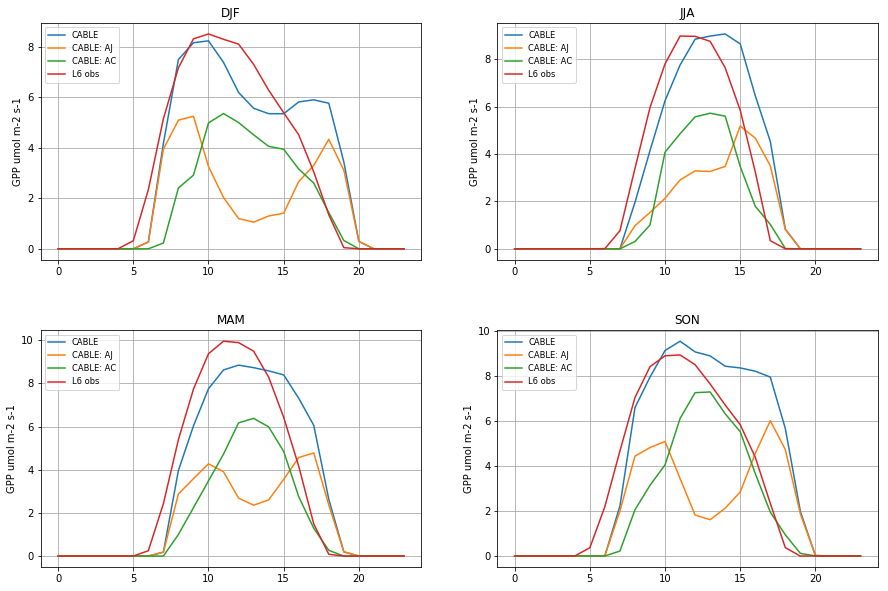

In [20]:
fig=plt.figure(figsize=(15, 10))
fig.subplots_adjust(hspace=0.3, wspace = 0.1)
x = dfs1[1].index
x1 = dfobs[1].index
sindex = [(0,0),(1,0),(0,1),(1,1)]
slabel = ['DJF', 'MAM', 'JJA', 'SON']
var = 'GPP'
units = 'umol m-2 s-1'
for i in range(4):
    ax = plt.subplot2grid((2,2),sindex[i])
    y1 = dfs1[i][var] 
    y3 = dfobs[i][var]
    y2 = dfs1[i]['GPP_sunlit_J'] + dfs1[i]['GPP_shaded_J']
    y2a = dfs1[i]['GPP_sunlit_C'] + dfs1[i]['GPP_shaded_C']
    print(y2a.sum())
    print(y2.sum())
    #y2=dfs[i]['GPP']
    plt.plot(x,y1,label="CABLE")
    plt.plot(x,y2,label="CABLE: AJ ")
    plt.plot(x,y2a,label="CABLE: AC")
    plt.plot(x1,y3,label="L6 obs")
    plt.grid(b=True, which='both', color='0.65', linestyle='-')
    plt.legend(fontsize='small',frameon=True,loc=2)
    ax.set_ylabel(var+' '+units)
    ax.set_title(slabel[i])
    
fig.subplots_adjust(hspace=0.3, wspace = 0.2)
fig.savefig(os.path.join(plot_dir, plot_fname_GPP), bbox_inches='tight',
                    pad_inches=0.1)

In [21]:
print(y2a.sum())
print(y2.sum())

48.6637
45.4146


In [31]:
289.08-273.15

15.930000000000007

dates
2001-01-01 01:00:00    15.929993
2001-01-01 02:00:00    15.446930
2001-01-01 03:00:00    15.003265
2001-01-01 04:00:00    14.590729
2001-01-01 05:00:00    14.203522
2001-01-01 06:00:00    14.081268
2001-01-01 07:00:00    16.392670
2001-01-01 08:00:00    18.644196
2001-01-01 09:00:00    20.782288
2001-01-01 10:00:00    22.756195
2001-01-01 11:00:00    24.519043
2001-01-01 12:00:00    26.028900
2001-01-01 13:00:00    27.249969
2001-01-01 14:00:00    28.153229
2001-01-01 15:00:00    28.717224
2001-01-01 16:00:00    28.928528
2001-01-01 17:00:00    28.559692
2001-01-01 18:00:00    27.355347
2001-01-01 19:00:00    25.496552
2001-01-01 20:00:00    23.266296
2001-01-01 21:00:00    20.261230
2001-01-01 22:00:00    19.005707
2001-01-01 23:00:00    18.056061
2001-01-02 00:00:00    17.259949
2001-01-02 01:00:00    16.552490
2001-01-02 02:00:00    15.921661
2001-01-02 03:00:00    15.342285
2001-01-02 04:00:00    14.803497
2001-01-02 05:00:00    14.297821
2001-01-02 06:00:00    14.121429
    

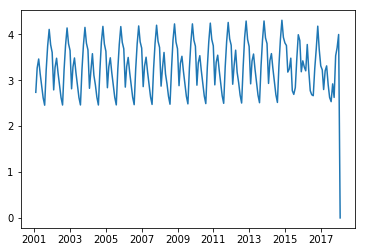

In [30]:
# plot monthly time-series
dfm1=df1.resample('M').mean()
plt.plot(dfm1['GPP'])
print(df1.Tair)

In [ ]:
plot_dir = '/Users/hav014/Data/BIOS3/CumbPlains/'
plot_fname = 'Cumberland_POP_CNP_out_cable_optimised_GPP_coord.pdf'
fig.savefig(os.path.join(plot_dir, plot_fname), bbox_inches='tight',
                    pad_inches=0.1)

In [ ]:
%pwd

In [ ]:
# plot different T response curves
importlib.reload(site)
from site import Q10, LT, varQ10, vcmx, Arrhenius , Genn1
str = 'a=1'
exec(str)
exec(site.plotdefaults)
print(linewidth)
T=np.arange(0, 30, 0.1)
#T=dfs[3]['Tair']
#x = dfs[1].index
Tref = 20
q10 = 1.5
Ea1 = 30
Ea2=58
#plt.plot(T,Q10(T,Tref,q10),label="Q10")
#plt.plot(T,LT(T,Tref),label='LT')
#plt.plot(T,varQ10(T,Tref),label='varQ10')
#plt.plot(T,Arrhenius(T,Tref,Ea1),label='Arr62')
#plt.plot(T,vcmx(T+273.15,25,Tref),label='vcmx25')
#plt.plot(T,vcmx(T+273.15,5,Tref),label='vcmx10')
#plt.plot(T,Genn1(T),label='Genn1')
plt.plot(T,Genn1(T)*vcmx(T+273.15,25,Tref),label='Genn1*vcmx')
plt.plot(T,vcmx(T+273.15,25,Tref),label='vcmx')
plt.legend(fontsize='small',frameon=False)
#plt.legend(fontsize='small',frameon=False)

In [ ]:
importlib.reload(site)

In [ ]:
dfs[3]['Tair']

In [ ]:
plt.plot(df['jmax']/df['vcmax'])
#plt.plot(df['GPP_shaded_J'])
#plt.show()

In [ ]:
df['GPP_sunlit_J'][0]=0
df['GPP_sunlit_C'][:24]

In [ ]:
CABLE_SITE_fname 

In [49]:
'time' in f.variables['Tair'].dimensions

True

In [64]:
f=nc.Dataset(met_filename1)
var_list = f.variables
print(type(var_list))
nc_dims = [dim for dim in f.dimensions]  # list of nc dimensions
df_met = pd.DataFrame()
for var in var_list:
    if var not in nc_dims:
        print ('\tName:', var)
        print ("\t\tdimensions:", f.variables[var].dimensions)
        print ("\t\tsize:", f.variables[var].size)
    if len(f.variables[var].dimensions)==3:
        df_met[var] = f.variables[var][:,0,0]
    elif len(f.variables[var].dimensions)==4:
        df_met[var] = f.variables[var][:,0,0,0]
    #if 'time' in f.variables[var].dimensions:
    #    df_met[var] = f.variables[var][:,0,0]  
df_met[:5]

<class 'collections.OrderedDict'>
	Name: latitude
		dimensions: ('y', 'x')
		size: 1
	Name: longitude
		dimensions: ('y', 'x')
		size: 1
	Name: SWdown
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: Tair
		dimensions: ('time', 'z', 'y', 'x')
		size: 149016
	Name: Rainf
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: Qair
		dimensions: ('time', 'z', 'y', 'x')
		size: 149016
	Name: Wind
		dimensions: ('time', 'z', 'y', 'x')
		size: 149016
	Name: PSurf
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: LWdown
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: SWdown_qc
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: Tair_qc
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: Rainf_qc
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: Qair_qc
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: Wind_qc
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: PSurf_qc
		dimensions: ('time', 'y', 'x')
		size: 149016
	Name: LWdown_qc
		dimensions: ('time', 

,SWdown,Tair,Rainf,Qair,Wind,PSurf,LWdown,SWdown_qc,Tair_qc,Rainf_qc,Qair_qc,Wind_qc,PSurf_qc,LWdown_qc,LAI
0,0.0,289.079987,0.0,0.009092,0.577427,100920.0,323.855072,1,1,1,1,1,1,1,1.5
1,0.0,288.596924,0.0,0.009124,0.577427,100920.0,321.695801,1,1,1,1,1,1,1,1.5
2,0.0,288.153259,0.0,0.009156,0.577427,100920.0,319.722260,1,1,1,1,1,1,1,1.5
3,0.0,287.740723,0.0,0.009187,0.577427,100920.0,317.895264,1,1,1,1,1,1,1,1.5
4,0.0,287.353516,0.0,0.009219,0.577427,100920.0,316.187653,1,1,1,1,1,1,1,1.5


ValueError: slicing expression exceeds the number of dimensions of the variable

In [ ]:
colnum = 8
plt.plot(data1[0:800:8,colnum])
plt.plot(data2[0:400:4,colnum])

In [ ]:
data1[0:100:4,0]

In [ ]:
filename1 = '/Users/hav014/Data/BIOS3/190125/site1.tmp'
filename2 = '/Users/hav014/Data/BIOS3/190125/bios1.tmp'
data1=np.loadtxt(filename1)
data2=np.loadtxt(filename2)

In [ ]:
colnum = 1
plt.plot(data1[0:48*5:2,colnum])
plt.plot(data2[0:24*5,colnum])

In [ ]:
data2[:10]

In [ ]:
Tref = 35
np.exp(308.56*(1.0/56.02-1.0/(np.maximum(Tref,-20.0)+46.02)))

In [ ]:
site.Arrhenius(35,35)

In [ ]:
site.Q10(35,35,2)

In [ ]:
importlib.reload(site)
x = np.arange(0,35,0.1)

In [ ]:
plt.plot(x,site.vap_diffusivity(x, 10))
plt.plot(x,site.liq_diffusivity(x, 10))

In [ ]:
10**(-1)

In [ ]:
dfs2[1]['TotSoilCarb']